# Business Intelligence Analyst Assessment
by Tamara Coglitore

Outline :
* Preparation
* Data Analysis
* Conclusion & Recommendation

### Preparation

#### Library and Import Datasets

In [345]:
# Library
import pandas as pd
import numpy as np

pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
import plotly.express as px

import missingno as msno

import datetime as dt

import contractions
from string import punctuation
import nltk
from nltk.corpus import stopwords
from nltk.stem import SnowballStemmer

import advertools as adv
from wordcloud import WordCloud

from googletrans import Translator, constants
from pprint import pprint

import sys
import warnings
if not sys.warnoptions:
    warnings.simplefilter("ignore")


In [346]:
# Import Datasets
# cutomers
df_customers = pd.read_csv('customers_dataset.csv')

# orders
df_orders = pd.read_csv('orders_dataset.csv')

# order items
df_order_items = pd.read_csv('order_items_dataset.csv')

# order payments
df_payments = pd.read_csv("order_payments_dataset.csv")

# products
df_products = pd.read_csv('products_dataset.csv')

# product category
df_cat = pd.read_csv('product_category_name_translation.csv')

# reviews
df_reviews = pd.read_csv('order_reviews_dataset.csv')

# sellers
df_sellers = pd.read_csv('sellers_dataset.csv')

# geolocation
df_geo = pd.read_csv('geolocation_dataset.csv')

#### Dataset information

This section will show each dataset variables. 

##### Customer

In [347]:
# Check customer dataset
df_customers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


This dataset show customer's informations including customer id (id and unique id) and location (zip code, city, & state).

##### Order information

Order information includes: 
* orders (order id, customer id, order status, & timestamp)
* order item (order id, product id, seller id, shipping date, price, & freight value)
* payments (order id, payment sequential, payment type, payment installments, & payment value) 
* products (product id, product category, & dimension)
* product category translation
* reviews (order id, score, title and comment, & timestamp)

In [348]:
# Check orders dataset
df_orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [349]:
# Check order items dataset
df_order_items.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


In [350]:
# Check payments dataset
df_payments.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [351]:
# Check products dataset
df_products.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [352]:
# Check category dataset
df_cat.head()

,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


In [353]:
# Check reviews dataset
df_reviews.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela Internet seguro e prático Parabéns a todos feliz Páscoa,2018-03-01 00:00:00,2018-03-02 10:26:53


##### Seller

In [354]:
# Check sellers dataset
df_sellers.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


This dataset shows seller id and location (zip code, city, & state)

##### Location

In [355]:
# Check geo dataset
df_geo.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


This dataset shows location information (zip code, latitude, longitude, city, & state)

#### Joining Dataset

Before joining dataset, it is a must to understand each dataset. The first step is to check the shape of each dataset. 

In [356]:
# Dataset shape (total row and columns)
dataset_ = [df_customers, df_orders, df_order_items, df_payments, df_products, df_cat, df_reviews, df_sellers,df_geo]
datasetname = ['Customers', 'Orders', 'Order Items', 'Payments', 'Products','Category', 'Reviews', 'Sellers', 'Location']
a = []
for i in range(len(dataset_)): 
    a.append([datasetname[i], dataset_[i].shape[0],dataset_[i].shape[1]])
    datasetshape = pd.DataFrame(a, columns= ['Dataset', 'row', 'columns'])
datasetshape

,Dataset,row,columns
0,Customers,99441,5
1,Orders,99441,8
2,Order Items,112650,7
3,Payments,103886,5
4,Products,32951,9
5,Category,71,2
6,Reviews,99224,7
7,Sellers,3095,4
8,Location,1000163,5


In [357]:
# Unique 
print(f'''cust id unique : {df_customers['customer_id'].nunique()},
order unique : {df_orders['order_id'].nunique()},
order items unique : {df_order_items['order_id'].nunique()},
payment unique : {df_payments['order_id'].nunique()},
review unique : {df_reviews['order_id'].nunique()}''')

cust id unique : 99441,
order unique : 99441,
order items unique : 98666,
payment unique : 99440,
review unique : 98673


The total rows of Customers and Orders dataset are both 99441, while Order Items and Payments are 112650 and 103886 respectively. After checking the unique order ID in Order Items and Payments dataset, it is known that in both datasets may have multiple order id showing that every transaction may contain more than 1 item and-or 1 payment sequential. The rows on each dataset are different for each order id. Moreover, in the review dataset, there are multiple review for 1 order id. Thus these datasets will not be combined/joined. 

The main datasets will be joined using inner join to prevent missing values, while the review, location and payment dataset will be joined later in Data Analysis to avoid duplication. 

In [358]:
# Join 
dataset = pd.merge(df_customers, df_orders, on = 'customer_id', how = 'inner')
dataset = pd.merge(dataset, df_order_items, on = 'order_id', how = 'inner')
dataset = pd.merge(dataset, df_products, on = 'product_id', how = 'inner')
dataset = pd.merge(dataset, df_cat, on = 'product_category_name', how = 'inner')
dataset = pd.merge(dataset, df_sellers, on = 'seller_id', how = 'inner')
dataset.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,seller_zip_code_prefix,seller_city,seller_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0,office_furniture,8577,itaquaquecetuba,SP
1,8912fc0c3bbf1e2fbf35819e21706718,9eae34bbd3a474ec5d07949ca7de67c0,68030,santarem,PA,c1d2b34febe9cd269e378117d6681172,delivered,2017-11-09 00:50:13,2017-11-10 00:47:48,2017-11-22 01:43:37,2017-11-28 00:09:50,2017-12-19 00:00:00,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-11-23 00:47:18,112.99,24.90,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0,office_furniture,8577,itaquaquecetuba,SP
2,8912fc0c3bbf1e2fbf35819e21706718,9eae34bbd3a474ec5d07949ca7de67c0,68030,santarem,PA,c1d2b34febe9cd269e378117d6681172,delivered,2017-11-09 00:50:13,2017-11-10 00:47:48,2017-11-22 01:43:37,2017-11-28 00:09:50,2017-12-19 00:00:00,2,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-11-23 00:47:18,112.99,24.90,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0,office_furniture,8577,itaquaquecetuba,SP
3,f0ac8e5a239118859b1734e1087cbb1f,3c799d181c34d51f6d44bbbc563024db,92480,nova santa rita,RS,b1a5d5365d330d10485e0203d54ab9e8,delivered,2017-05-07 20:11:26,2017-05-08 22:22:56,2017-05-19 20:16:31,2017-05-26 09:54:04,2017-06-12 00:00:00,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 22:22:56,124.99,15.62,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0,office_furniture,8577,itaquaquecetuba,SP
4,6bc8d08963a135220ed6c6d098831f84,23397e992b09769faf5e66f9e171a241,25931,mage,RJ,2e604b3614664aa66867856dba7e61b7,delivered,2018-02-03 19:45:40,2018-02-04 22:29:19,2018-02-19 18:21:47,2018-02-28 21:09:00,2018-03-22 00:00:00,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2018-02-18 21:29:19,106.99,30.59,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0,office_furniture,8577,itaquaquecetuba,SP


In [359]:
dataset.shape

(111023, 30)

#### Data Cleaning

##### Duplicate

Check data duplicate to avoid bias in analysis.

In [360]:
# Main dataset
dataset.duplicated().sum()

0

In [361]:
# Payment dataset
df_payments.duplicated().sum()

0

In [362]:
# Review dataset
df_reviews.duplicated().sum()

0

There is no duplicated row. 

##### Dropping Irrelevant Columns

Text(0.5, 1.0, 'Correlation Matrix')

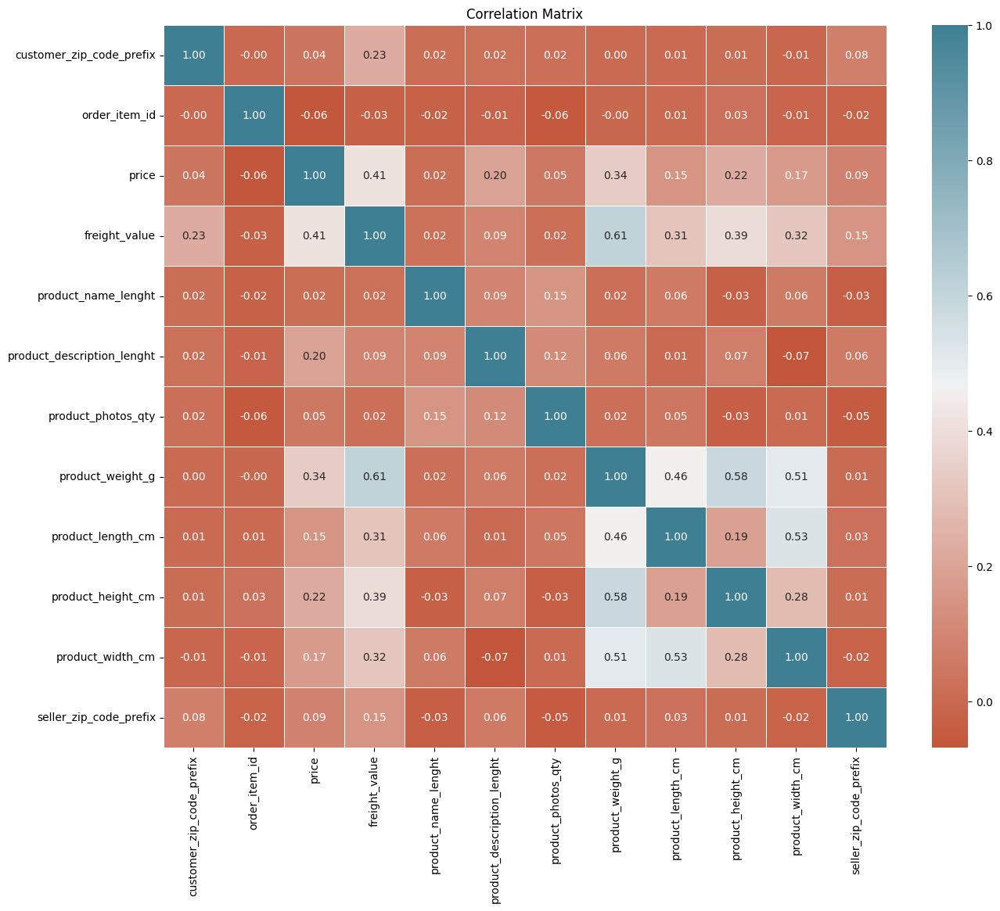

In [363]:
# Correlation Matrix Heatmap
plt.figure(figsize=(15, 12))
palette=sns.diverging_palette(20, 220, n=256)
sns.heatmap(dataset.corr(),annot=True, fmt='.2f',cmap=palette,square=True, linewidths=.5)
plt.title('Correlation Matrix')

There are some irrelevant columns to the analysis, which are:
* `product_category_name` is product category in Portuguese and is already represented by `product_category_name_english` column, so it will be dropped
* Product dimensions, which are `product_length_cm`, `product_height_cm`, and `product_width_cm` are relevant to freight price, but can be and better represented by `product_weight_g` based on the correlation matrix above
* Product page information such as `product_name_length`, `product_description_length`, and `product_photos_qty` have low correlation to other variables (<0.2), will not be used for analysis

In [364]:
# Dropping unused columns
dataset.drop(['product_category_name','product_length_cm', 'product_height_cm','product_width_cm', 'product_name_lenght','product_description_lenght', 'product_photos_qty'], axis = 1, inplace = True)

Next is to change the 'product_category_name_english' to 'product_category'. 

In [365]:
dataset = dataset.rename(columns={'product_category_name_english': 'product_category'})

In [366]:
# Check Dataset
dataset.columns

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state', 'order_id', 'order_status',
       'order_purchase_timestamp', 'order_approved_at',
       'order_delivered_carrier_date', 'order_delivered_customer_date',
       'order_estimated_delivery_date', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'product_weight_g', 'product_category', 'seller_zip_code_prefix',
       'seller_city', 'seller_state'],
      dtype='object')

##### Missing Value

Missing value in analysis can also cause bias. Checking and understanding the missing value can help identify how to handle the missing data. 

In [367]:
# Check missing value
display(dataset.isna().sum(), df_payments.isna().sum(), df_reviews.isna().sum(), df_geo.isna().sum())

customer_id                         0
customer_unique_id                  0
customer_zip_code_prefix            0
customer_city                       0
customer_state                      0
order_id                            0
order_status                        0
order_purchase_timestamp            0
order_approved_at                  14
order_delivered_carrier_date     1155
order_delivered_customer_date    2386
order_estimated_delivery_date       0
order_item_id                       0
product_id                          0
seller_id                           0
shipping_limit_date                 0
price                               0
freight_value                       0
product_weight_g                    1
product_category                    0
seller_zip_code_prefix              0
seller_city                         0
seller_state                        0
dtype: int64

order_id                0
payment_sequential      0
payment_type            0
payment_installments    0
payment_value           0
dtype: int64

review_id                      0
order_id                       0
review_score                   0
review_comment_title       87656
review_comment_message     58247
review_creation_date           0
review_answer_timestamp        0
dtype: int64

geolocation_zip_code_prefix    0
geolocation_lat                0
geolocation_lng                0
geolocation_city               0
geolocation_state              0
dtype: int64

There happened to be missing value in some columns which are `order_approved_at`, `order_delivered_carrier_date`, `order_delivered_customer_date`, `product_weight_g`, `review_comment_title` and `review_comment_message`. Next step is understanding missingness in each column.  

* **order_approved_at**

Based on domain knowledge of e-commerce, order_approved_at is where customer placed an order and seller accept the order.

In [368]:
# Checking order status and delivered customer date
dataset[dataset['order_approved_at'].isna() == True]['order_status']

16022     delivered
16071     delivered
16141     delivered
31212     delivered
36348     delivered
56258     delivered
56259     delivered
59478     delivered
68075     delivered
94233     delivered
99198     delivered
102464    delivered
102505    delivered
102535    delivered
Name: order_status, dtype: object

In [369]:
# Percentage
print(f'''percentage missing value order_approved_at : {round(dataset['order_approved_at'].isna().sum()/dataset.shape[0]*100, 2)}%''')

percentage missing value order_approved_at : 0.01%


The missing value on `order_approved_at` have `order_status` as delivered, missingness is completely at random (MCAR) and has low percentage, 0.01%, thus rows with missing value will be dropped. 

In [370]:
# Removing missing value
dataset.dropna(subset = ['order_approved_at'],axis = 0, inplace = True)

In [371]:
# Check
dataset['order_approved_at'].isna().sum()

0

* **order_delivered_carrier_date & order_delivered_customer_date**

Text(0.5, 1.0, 'Missingness Matrix')

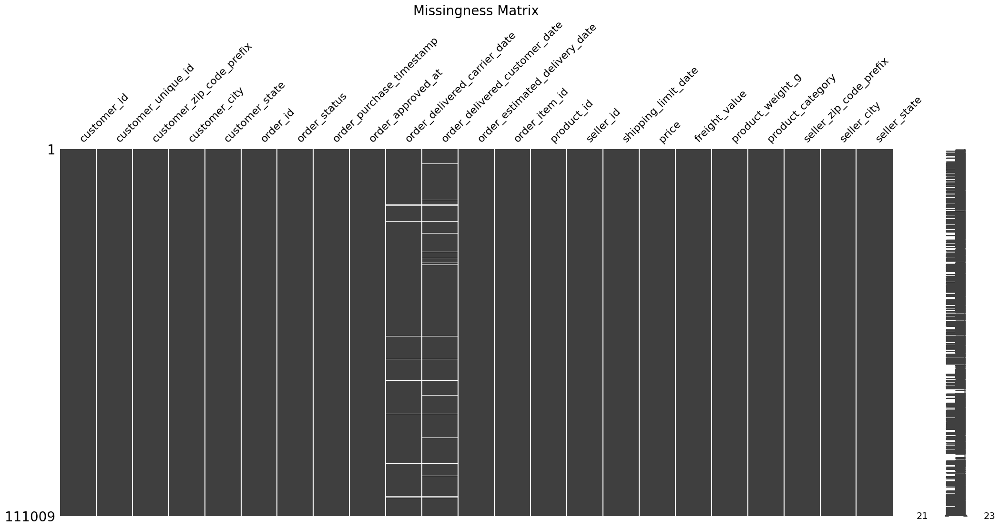

In [372]:
# Missingness matrix
msno.matrix(dataset)
plt.title('Missingness Matrix',fontsize = 20)

The white columns show row with missing value. `order_delivered_carrier_date` & `order_delivered_customer_date` show that they almost have the same pattern. 

Text(0.5, 1.0, 'Missingness Matrix')

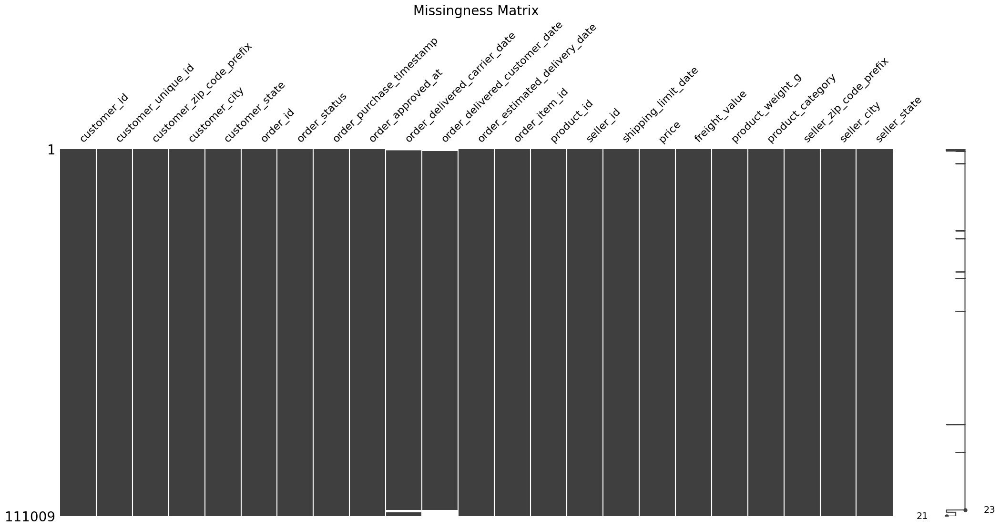

In [373]:
# Checking for any pattern in missingness
msno.matrix(dataset.sort_values(by='order_status'))
plt.title('Missingness Matrix',fontsize = 20)

After the data is sorted by `order_status` it is shown that the missing data have connection to that column, so it is known that the type of missingness is missing at random(MAR), where the missing value is connected to other variable.

In [374]:
# Checking order status of each column
print(dataset[dataset['order_delivered_carrier_date'].isna()== True]['order_status'].unique(),
dataset[dataset['order_delivered_customer_date'].isna()== True]['order_status'].unique())

['invoiced' 'canceled' 'processing' 'approved' 'delivered' 'unavailable'] ['shipped' 'invoiced' 'canceled' 'processing' 'approved' 'delivered'
 'unavailable']


Based on the order status, it is reasonable that there are missing data of delivered date because the item may not be delivered yet, cancelled or unavailable. So every missing value with order status other than delivered will not be treated. Next step is to check data with 'delivered' as order status. 

In [375]:
# Check data delivered
dataset[(dataset['order_delivered_carrier_date'].isna()== True)&(dataset['order_status'] == 'delivered')]

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_weight_g,product_category,seller_zip_code_prefix,seller_city,seller_state
46140,e08caf668d499a6d643dafd7c5cc498a,d77cf4be2654aa70ef150f8bfec076a6,91330,porto alegre,RS,2d858f451373b04fb5c984a1cc2defaf,delivered,2017-05-25 23:22:43,2017-05-25 23:30:16,NaN,NaN,2017-06-23 00:00:00,1,30b5b5635a79548a48d04162d971848f,f9bbdd976532d50b7816d285a22bd01e,2017-06-04 23:30:16,179.0,15.00,900.0,sports_leisure,5319,sao paulo,SP
70487,afeb16c7f46396c0ed54acb45ccaaa40,a2ac81ecc3704410ae240e74d4f0af40,13334,indaiatuba,SP,2aa91108853cecb43c84a5dc5b277475,delivered,2017-09-29 08:52:58,2017-09-29 09:07:16,NaN,2017-11-20 19:44:47,2017-11-14 00:00:00,1,44c2baf621113fa7ac95fa06b4afbc68,3f2af2670e104d1bcb54022274daeac5,2017-10-18 10:07:16,179.0,14.98,7000.0,furniture_decor,87240,terra boa,PR


In [376]:
# Check data delivered
dataset[(dataset['order_delivered_customer_date'].isna()== True)&(dataset['order_status'] == 'delivered')]

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_weight_g,product_category,seller_zip_code_prefix,seller_city,seller_state
46140,e08caf668d499a6d643dafd7c5cc498a,d77cf4be2654aa70ef150f8bfec076a6,91330,porto alegre,RS,2d858f451373b04fb5c984a1cc2defaf,delivered,2017-05-25 23:22:43,2017-05-25 23:30:16,NaN,NaN,2017-06-23 00:00:00,1,30b5b5635a79548a48d04162d971848f,f9bbdd976532d50b7816d285a22bd01e,2017-06-04 23:30:16,179.00,15.00,900.0,sports_leisure,5319,sao paulo,SP
55130,dd1b84a7286eb4524d52af4256c0ba24,cce5e8188bf42ffb3bb5b18ff58f5965,7261,guarulhos,SP,ab7c89dc1bf4a1ead9d6ec1ec8968a84,delivered,2018-06-08 12:09:39,2018-06-08 12:36:39,2018-06-12 14:10:00,NaN,2018-06-26 00:00:00,1,a2a7efc985315e86d4f0f705701b342b,ed4acab38528488b65a9a9c603ff024a,2018-06-18 12:30:35,110.99,9.13,1133.0,computers_accessories,8260,sao paulo,SP
63782,29f0540231702fda0cfdee0a310f11aa,1bd06a0c0df8b23dacfd3725d2dc0bb9,12445,pindamonhangaba,SP,2ebdfc4f15f23b91474edf87475f108e,delivered,2018-07-01 17:05:11,2018-07-01 17:15:12,2018-07-03 13:57:00,NaN,2018-07-30 00:00:00,1,e7d5464b94c9a5963f7c686fc80145ad,58f1a6197ed863543e0136bdedb3fce2,2018-07-05 17:15:12,139.00,19.07,275.0,watches_gifts,36407,conselheiro lafaiete,MG
63797,cfda40ca8dd0a5d486a9635b611b398a,3bc508d482a402715be4d5cf4020cc81,13170,sumare,SP,e69f75a717d64fc5ecdfae42b2e8e086,delivered,2018-07-01 22:05:55,2018-07-01 22:15:14,2018-07-03 13:57:00,NaN,2018-07-30 00:00:00,1,e7d5464b94c9a5963f7c686fc80145ad,58f1a6197ed863543e0136bdedb3fce2,2018-07-05 22:15:14,139.00,19.07,275.0,watches_gifts,36407,conselheiro lafaiete,MG
63959,4f1d63d35fb7c8999853b2699f5c7649,ebf7e0d43a78c81991a4c59c145c75db,13560,sao carlos,SP,0d3268bad9b086af767785e3f0fc0133,delivered,2018-07-01 21:14:02,2018-07-01 21:29:54,2018-07-03 09:28:00,NaN,2018-07-24 00:00:00,1,ec165cd31c50585786ffda6feff5d0a6,8bdd8e3fd58bafa48af76b2c5fd71974,2018-07-05 21:29:54,188.99,15.63,967.0,toys,1552,sao paulo,SP
74150,ec05a6d8558c6455f0cbbd8a420ad34f,13467e882eb3a701826435ee4424f2bd,18520,cerquilho,SP,2d1e2d5bf4dc7227b3bfebb81328c15f,delivered,2017-11-28 17:44:07,2017-11-28 17:56:40,2017-11-30 18:12:23,NaN,2017-12-18 00:00:00,1,a50acd33ba7a8da8e9db65094fa990a4,8581055ce74af1daba164fdbd55a40de,2017-12-04 17:56:40,117.30,17.53,4105.0,auto,7112,guarulhos,SP
94908,5e89028e024b381dc84a13a3570decb4,2f17c5b324ad603491521b279a9ff4de,18255,quadra,SP,f5dd62b788049ad9fc0526e3ad11a097,delivered,2018-06-20 06:58:43,2018-06-20 07:19:05,2018-06-25 08:05:00,NaN,2018-07-16 00:00:00,1,2167c8f6252667c0eb9edd51520706a1,0bb738e4d789e63e2267697c42d35a2d,2018-06-26 07:19:05,329.00,25.24,7750.0,industry_commerce_and_business,18130,sao roque,SP
109535,28c37425f1127d887d7337f284080a0f,175378436e2978be55b8f4316bce4811,9431,ribeirao pires,SP,20edc82cf5400ce95e1afacc25798b31,delivered,2018-06-27 16:09:12,2018-06-27 16:29:30,2018-07-03 19:26:00,NaN,2018-07-19 00:00:00,1,55bfa0307d7a46bed72c492259921231,343e716476e3748b069f980efbaa294e,2018-07-03 16:29:30,45.90,9.07,550.0,books_general_interest,13033,campinas,SP


In [377]:
# Percentage
print(f'''percentage missing value order_delivered_carrier_date : {round(len(dataset[(dataset['order_delivered_carrier_date'].isna()== True)&(dataset['order_status'] == 'delivered')])/dataset.shape[0]*100, 3)}%,
percentage missing value order_delivered_customer_date : {round(len(dataset[(dataset['order_delivered_customer_date'].isna()== True)&(dataset['order_status'] == 'delivered')])/dataset.shape[0]*100, 3)}%''')

percentage missing value order_delivered_carrier_date : 0.002%,
percentage missing value order_delivered_customer_date : 0.007%


`order_delivered_carrier_date`: based on `shipping_limit_date` doesn't show any pattern.   
`order_delivered_customer_date`: based on `order_estimated_delivery_date` doesn't show any pattern.   
Both data with delivered order status is below 0.01%, thus those rows will be removed. 

In [378]:
# Drop row
index1 = list(dataset[(dataset['order_delivered_carrier_date'].isna()== True)&(dataset['order_status'] == 'delivered')].index)
index2 = list(dataset[(dataset['order_delivered_customer_date'].isna()== True)&(dataset['order_status'] == 'delivered')].index)
index3 = index1 + list(set(index2) - set(index1))
dataset.drop(index3, inplace = True)

In [379]:
# Check
print(f'''order_delivered_carrier_date : {len(dataset[(dataset['order_delivered_carrier_date'].isna()== True)&(dataset['order_status'] == 'delivered')])}
order_delivered_customer_date : {len(dataset[(dataset['order_delivered_customer_date'].isna()== True)&(dataset['order_status'] == 'delivered')])}''')

order_delivered_carrier_date : 0
order_delivered_customer_date : 0


* **product_weight_g**

There is only 1 row with missing value, row will be dropped. 

In [380]:
dataset.dropna(subset='product_weight_g', axis = 0, inplace = True)
dataset['product_weight_g'].isna().sum()

0

* **review_comment_title & review_comment_message**

In [381]:
# Percentage
print(f'''percentage missing value review_comment_title : {round(df_reviews['review_comment_title'].isna().sum()/df_reviews.shape[0]*100, 2)}%,
percentage missing value review_comment_message : {round(df_reviews['review_comment_message'].isna().sum()/df_reviews.shape[0]*100, 2)}%''')

percentage missing value review_comment_title : 88.34%,
percentage missing value review_comment_message : 58.7%


Due to the high missing values on `review_comment_title` which is 88.34%, the column will be deleted and will be represented by `review_comment_message`.

In [382]:
# Drop column
df_reviews.drop('review_comment_title', axis = 1, inplace = True)

Text(0.5, 1.0, 'Missingness Matrix')

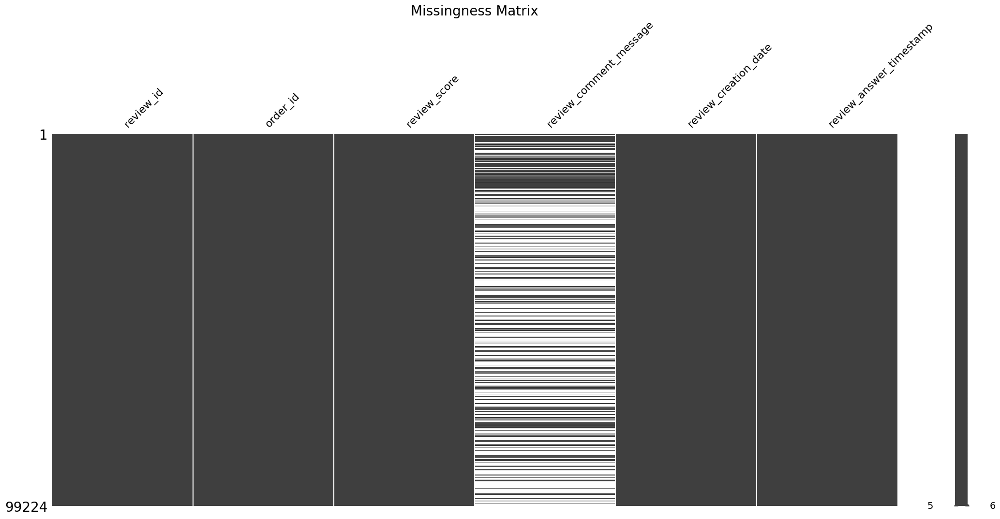

In [383]:
# Checking for any pattern in missingness
msno.matrix(df_reviews.sort_values(by='review_score'))
plt.title('Missingness Matrix',fontsize = 20)

After some trial with sorting different variables, it is known that there are no pattern in `review_comment_message`. Based on domain knowledge it is reasonable that not every customer leave a review comment, the missing value will be filled with 'no comment'. 

In [384]:
# Change nan to no comment
df_reviews['review_comment_message']=df_reviews['review_comment_message'].replace({np.nan:'No Comment'})
df_reviews.isna().sum()

review_id                  0
order_id                   0
review_score               0
review_comment_message     0
review_creation_date       0
review_answer_timestamp    0
dtype: int64

##### Data Type

Adjust data type based on variables.

In [385]:
display(dataset.info(), df_payments.info(), df_reviews.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110999 entries, 0 to 111022
Data columns (total 23 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   customer_id                    110999 non-null  object 
 1   customer_unique_id             110999 non-null  object 
 2   customer_zip_code_prefix       110999 non-null  int64  
 3   customer_city                  110999 non-null  object 
 4   customer_state                 110999 non-null  object 
 5   order_id                       110999 non-null  object 
 6   order_status                   110999 non-null  object 
 7   order_purchase_timestamp       110999 non-null  object 
 8   order_approved_at              110999 non-null  object 
 9   order_delivered_carrier_date   109846 non-null  object 
 10  order_delivered_customer_date  108621 non-null  object 
 11  order_estimated_delivery_date  110999 non-null  object 
 12  order_item_id                 

None

None

None

In [386]:
# Change data type from object to datetime
time = ['order_purchase_timestamp', 'order_approved_at', 'order_delivered_carrier_date', 'order_delivered_customer_date', 'order_estimated_delivery_date','shipping_limit_date']
for i in time:
    dataset[i] = pd.to_datetime(dataset[i])
    dataset[i] = dataset[i].dt.strftime('%Y/%m/%d')
    dataset[i] = pd.to_datetime(dataset[i])
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110999 entries, 0 to 111022
Data columns (total 23 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   customer_id                    110999 non-null  object        
 1   customer_unique_id             110999 non-null  object        
 2   customer_zip_code_prefix       110999 non-null  int64         
 3   customer_city                  110999 non-null  object        
 4   customer_state                 110999 non-null  object        
 5   order_id                       110999 non-null  object        
 6   order_status                   110999 non-null  object        
 7   order_purchase_timestamp       110999 non-null  datetime64[ns]
 8   order_approved_at              110999 non-null  datetime64[ns]
 9   order_delivered_carrier_date   109846 non-null  datetime64[ns]
 10  order_delivered_customer_date  108621 non-null  datetime64[ns]
 11  

In [387]:
# df_review change data type
columns = ['review_creation_date', 'review_answer_timestamp']
for i in columns:
    df_reviews[i] = pd.to_datetime(df_reviews[i])
    df_reviews[i] = df_reviews[i].dt.strftime('%Y/%m/%d')
    df_reviews[i] = pd.to_datetime(df_reviews[i])
df_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 6 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   review_id                99224 non-null  object        
 1   order_id                 99224 non-null  object        
 2   review_score             99224 non-null  int64         
 3   review_comment_message   99224 non-null  object        
 4   review_creation_date     99224 non-null  datetime64[ns]
 5   review_answer_timestamp  99224 non-null  datetime64[ns]
dtypes: datetime64[ns](2), int64(1), object(3)
memory usage: 4.5+ MB


##### Outliers and Anomaly

Understanding outlier is important, if there happen to be extreme outliers it can cause bias in analysis results and degrades efficiency of the data. The cause of outliers must be known to determine what treatment will be given. Moreover categoric data will be checked if there are any anomalies or typos. 

* **Quantitative Data**

In [388]:
# Check for Quantitative Data 
display(dataset.columns, df_payments.columns, df_reviews.columns)

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state', 'order_id', 'order_status',
       'order_purchase_timestamp', 'order_approved_at',
       'order_delivered_carrier_date', 'order_delivered_customer_date',
       'order_estimated_delivery_date', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'product_weight_g', 'product_category', 'seller_zip_code_prefix',
       'seller_city', 'seller_state'],
      dtype='object')

Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value'],
      dtype='object')

Index(['review_id', 'order_id', 'review_score', 'review_comment_message',
       'review_creation_date', 'review_answer_timestamp'],
      dtype='object')

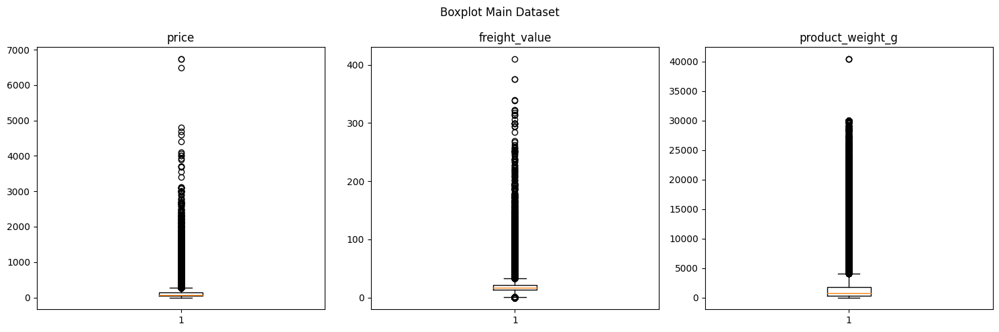

In [389]:
# Checking Outliers with Boxplot
numericdataset = ['price', 'freight_value', 'product_weight_g']
plt.figure(figsize=(15,5))
a = 0
for i in numericdataset:
  plt.subplot(1,3,a+1)
  plt.boxplot(dataset[i])
  plt.title(i)
  a+=1
  plt.tight_layout()
  plt.suptitle('Boxplot Main Dataset')

In [390]:
# Outliers in price
dataset[dataset['price']>6000]

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_weight_g,product_category,seller_zip_code_prefix,seller_city,seller_state
18912,c6e2731c5b391845f6800c97401a43a9,dc4802a71eae9be1dd28f5d788ceb526,79042,campo grande,MS,0812eb902a67711a1cb742b3cdaa65ae,delivered,2017-02-12,2017-02-12,2017-02-16,2017-03-03,2017-03-09,1,489ae2aa008f021502940f251d4cce7f,e3b4998c7a498169dc7bce44e6bb6277,2017-02-16,6735.0,194.31,30000.0,housewares,3635,sao paulo,SP
105909,3fd6777bbce08a352fddd04e4a7cc8f6,ff4159b92c40ebe40454e3e6a7c35ed6,17506,marilia,SP,f5136e38d1a14a4dbd87dff67da82701,delivered,2017-05-24,2017-05-26,2017-05-26,2017-06-05,2017-06-28,1,1bdf5e6731585cf01aa8169c7028d6ad,ee27a8f15b1dded4d213a468ba4eb391,2017-06-15,6499.0,227.66,7400.0,art,74210,goiania,GO
110873,f48d464a0baaea338cb25f816991ab1f,459bef486812aa25204be022145caa62,29066,vitoria,ES,fefacc66af859508bf1a7934eab1e97f,delivered,2018-07-25,2018-07-27,2018-08-03,2018-08-15,2018-08-10,1,69c590f7ffc7bf8db97190b6cb6ed62e,80ceebb4ee9b31afb6c6a916a574a1e2,2018-08-02,6729.0,193.21,5660.0,computers,86026,londrina,PR


In [391]:
# Outliers in freight value
dataset[dataset['freight_value']>350]

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_weight_g,product_category,seller_zip_code_prefix,seller_city,seller_state
23199,f2c743697f9b2ff2902df23a16582d80,5e92460d739e8dd987e279285a1d278c,88053,florianopolis,SC,3fde74c28a3d5d618c00f26d51baafa0,delivered,2018-08-13,2018-08-15,2018-08-15,2018-08-24,2018-09-05,1,a3cd9517ebf5a50dca25acce54f3b171,6fa9202c10491e472dffd59a3e82b2a3,2018-08-22,2338.08,375.28,30000.0,housewares,18030,sorocaba,SP
23200,f08306b95370e8d5f0d97b71229284b6,f140f377d666848e3712b51a2734d120,87013,maringa,PR,076d1555fb53a89b0ef4d529e527a0f6,delivered,2018-07-30,2018-08-01,2018-08-02,2018-08-08,2018-08-14,1,a3cd9517ebf5a50dca25acce54f3b171,6fa9202c10491e472dffd59a3e82b2a3,2018-08-07,2338.08,375.28,30000.0,housewares,18030,sorocaba,SP
103646,4eed76c1aafeceac4250e202ca9b1a5a,97734fdca127fddcb5f92f841690c3f2,64770,sao raimundo nonato,PI,a77e1550db865202c56b19ddc6dc4d53,delivered,2018-04-16,2018-04-19,2018-04-19,2018-04-27,2018-05-17,1,ec31d2a17b299511e7c8627be9337b9b,257e61d3251fb5efb9daadddbc2cf7ca,2018-04-25,979.00,409.68,14675.0,baby,86804,apucarana,PR


In [392]:
# Outliers in weight
dataset[dataset['product_weight_g']>35000]

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_weight_g,product_category,seller_zip_code_prefix,seller_city,seller_state
97652,958279c23050d6207d196c3057648f6f,de00290d2a997f24e1706fdc2d366a0e,11730,mongagua,SP,6ecf1a4051b4c5ed613624b460970a26,delivered,2017-11-17,2017-11-17,2017-11-17,2017-12-01,2017-12-06,1,26644690fde745fc4654719c3904e1db,1835b56ce799e6a4dc4eddc053f04066,2017-11-23,80.0,12.06,40425.0,bed_bath_table,14940,ibitinga,SP
97653,ccd6a4af78390b7ae560c1cc1cb1a2ff,32d0420a22921ea161d8bff0e0297b71,88820,icara,SC,4a45f9f66971302cf881ecfa142f42ba,delivered,2017-12-23,2017-12-23,2017-12-28,2018-01-25,2018-01-29,1,26644690fde745fc4654719c3904e1db,1835b56ce799e6a4dc4eddc053f04066,2017-12-29,80.0,16.32,40425.0,bed_bath_table,14940,ibitinga,SP
97654,51934b734e94e61d8efa4523e175c6c3,4fbb5c68b6851f6e35c543f963b43e4c,86455,joaquim tavora,PR,9223919b300f6989e1715333fca0d6ce,delivered,2018-03-01,2018-03-01,2018-03-02,2018-03-27,2018-03-26,1,26644690fde745fc4654719c3904e1db,1835b56ce799e6a4dc4eddc053f04066,2018-03-07,80.0,16.32,40425.0,bed_bath_table,14940,ibitinga,SP


There are outliers as shown above, due to the high variance of the data and looking at the other variables, it is reasonable to have outliers. Check based on:
* High price -> Category
* High freight value -> Weight, category, and location
* High weight value -> Category  


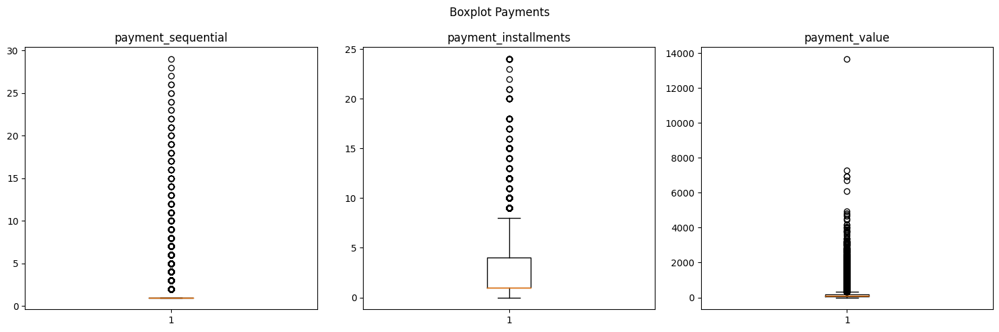

In [393]:
# Checking Outliers with Boxplot
numericdataset = ['payment_sequential', 'payment_installments', 'payment_value']
plt.figure(figsize=(15,5))
a = 0
for i in numericdataset:
  plt.subplot(1,3,a+1)
  plt.boxplot(df_payments[i])
  plt.title(i)
  a+=1
  plt.tight_layout()
  plt.suptitle('Boxplot Payments')

In [394]:
# Check outlier of payment sequential
df_payments[df_payments['payment_sequential']>26]

,order_id,payment_sequential,payment_type,payment_installments,payment_value
4885,fa65dad1b0e818e3ccc5cb0e39231352,27,voucher,1,66.02
39108,fa65dad1b0e818e3ccc5cb0e39231352,29,voucher,1,19.26
39111,fa65dad1b0e818e3ccc5cb0e39231352,28,voucher,1,29.05


In [395]:
# Check payment sequential based on order_id
df_payments[df_payments['order_id']=='fa65dad1b0e818e3ccc5cb0e39231352']

,order_id,payment_sequential,payment_type,payment_installments,payment_value
4885,fa65dad1b0e818e3ccc5cb0e39231352,27,voucher,1,66.02
9985,fa65dad1b0e818e3ccc5cb0e39231352,4,voucher,1,29.16
14321,fa65dad1b0e818e3ccc5cb0e39231352,1,voucher,1,3.71
17274,fa65dad1b0e818e3ccc5cb0e39231352,9,voucher,1,1.08
19565,fa65dad1b0e818e3ccc5cb0e39231352,10,voucher,1,12.86
23074,fa65dad1b0e818e3ccc5cb0e39231352,2,voucher,1,8.51
24879,fa65dad1b0e818e3ccc5cb0e39231352,25,voucher,1,3.68
28330,fa65dad1b0e818e3ccc5cb0e39231352,5,voucher,1,0.66
29648,fa65dad1b0e818e3ccc5cb0e39231352,6,voucher,1,5.02
32519,fa65dad1b0e818e3ccc5cb0e39231352,11,voucher,1,4.03


From data above it is show that a customer paid with 29 types of voucher, it is not an anomaly or typo. Therefore no treatment is given to the outlier.

In [396]:
# Check outlier of payment installments
df_payments[df_payments['payment_installments']>15]['payment_type'].unique()

array(['credit_card'], dtype=object)

Every payment with more than 15 payment installments used credit_card as payment_type, based on domain knowledge it is reasonable. No treatment is given to the outlier.

In [397]:
# Check outlier of payment value
df_payments[df_payments['payment_value']>10000]

,order_id,payment_sequential,payment_type,payment_installments,payment_value
52107,03caa2c082116e1d31e67e9ae3700499,1,credit_card,1,13664.08


In [398]:
# Check order for the order id on the main dataset
dataset[dataset['order_id']=='03caa2c082116e1d31e67e9ae3700499']

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_weight_g,product_category,seller_zip_code_prefix,seller_city,seller_state
84678,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,20080,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29,2017-10-02,2017-10-10,2017-10-17,2017-10-23,1,5769ef0a239114ac3a854af00df129e4,b37c4c02bda3161a7546a4e6d222d5b2,2017-10-06,1680.0,28.01,750.0,fixed_telephony,3667,sao paulo,SP
84679,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,20080,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29,2017-10-02,2017-10-10,2017-10-17,2017-10-23,2,5769ef0a239114ac3a854af00df129e4,b37c4c02bda3161a7546a4e6d222d5b2,2017-10-06,1680.0,28.01,750.0,fixed_telephony,3667,sao paulo,SP
84680,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,20080,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29,2017-10-02,2017-10-10,2017-10-17,2017-10-23,3,5769ef0a239114ac3a854af00df129e4,b37c4c02bda3161a7546a4e6d222d5b2,2017-10-06,1680.0,28.01,750.0,fixed_telephony,3667,sao paulo,SP
84681,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,20080,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29,2017-10-02,2017-10-10,2017-10-17,2017-10-23,4,5769ef0a239114ac3a854af00df129e4,b37c4c02bda3161a7546a4e6d222d5b2,2017-10-06,1680.0,28.01,750.0,fixed_telephony,3667,sao paulo,SP
84682,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,20080,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29,2017-10-02,2017-10-10,2017-10-17,2017-10-23,5,5769ef0a239114ac3a854af00df129e4,b37c4c02bda3161a7546a4e6d222d5b2,2017-10-06,1680.0,28.01,750.0,fixed_telephony,3667,sao paulo,SP
84683,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,20080,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29,2017-10-02,2017-10-10,2017-10-17,2017-10-23,6,5769ef0a239114ac3a854af00df129e4,b37c4c02bda3161a7546a4e6d222d5b2,2017-10-06,1680.0,28.01,750.0,fixed_telephony,3667,sao paulo,SP
84684,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,20080,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29,2017-10-02,2017-10-10,2017-10-17,2017-10-23,7,5769ef0a239114ac3a854af00df129e4,b37c4c02bda3161a7546a4e6d222d5b2,2017-10-06,1680.0,28.01,750.0,fixed_telephony,3667,sao paulo,SP
84685,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,20080,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29,2017-10-02,2017-10-10,2017-10-17,2017-10-23,8,5769ef0a239114ac3a854af00df129e4,b37c4c02bda3161a7546a4e6d222d5b2,2017-10-06,1680.0,28.01,750.0,fixed_telephony,3667,sao paulo,SP


In [399]:
# Check if data from payment and order item matches
check = dataset[dataset['order_id']=='03caa2c082116e1d31e67e9ae3700499']['price'].sum()+dataset[dataset['order_id']=='03caa2c082116e1d31e67e9ae3700499']['freight_value'].sum()
check

13664.08

Both from payments dataset and order item dataset matches and have the same value, 13664.08, moreover there are multiple items and multiple shipment payment meaning that it is reasonable and showing the data is not an anomaly. No treatment is given.

* **Qualitative Data**

In [400]:
# Categoric Function
def categoric(data):
    catcol = data.select_dtypes(include='object').columns
    cat1= []
    for i in catcol:
        if data[i].nunique()<=650:
            cat1.append(i)
        else:
            continue

    listItem = []
    for col in data[cat1] :
        listItem.append([col, data[col].nunique(), data[col].unique()])

    dfCat = pd.DataFrame(columns=['dataFeatures','unique', 'uniqueSample'],
                        data=listItem)
    return dfCat

In [401]:
# Check for anomaly
categoric(dataset)

,dataFeatures,unique,uniqueSample
0,customer_state,27,"[SP, PA, RS, RJ, SC, MG, MT, BA, ES, PR, MS, CE, RN, TO, MA, GO, PI, PE, DF, PB, AL, SE, RO, AC, RR, AM, AP]"
1,order_status,7,"[delivered, shipped, invoiced, canceled, processing, approved, unavailable]"
2,product_category,71,"[office_furniture, sports_leisure, furniture_decor, auto, baby, furniture_living_room, kitchen_dining_laundry_garden_furniture, health_beauty, housewares, computers_accessories, toys, garden_tools, pet_shop, watches_gifts, perfumery, stationery, construction_tools_lights, cool_stuff, home_appliances, signaling_and_security, construction_tools_construction, audio, market_place, electronics, telephony, art, small_appliances, costruction_tools_tools, musical_instruments, industry_commerce_and_business, food, fixed_telephony, agro_industry_and_commerce, luggage_accessories, furniture_bedroom, air_conditioning, bed_bath_table, home_appliances_2, small_appliances_home_oven_and_coffee, home_construction, fashion_bags_accessories, costruction_tools_garden, fashion_male_clothing, fashion_shoes, fashion_underwear_beach, consoles_games, home_confort, furniture_mattress_and_upholstery, fashion_sport, party_supplies, fashion_childrens_clothes, christmas_supplies, fashio_female_clothing, construction_tools_safety, drinks, books_general_interest, cine_photo, la_cuisine, food_drink, music, computers, arts_and_craftmanship, books_technical, books_imported, tablets_printing_image, flowers, cds_dvds_musicals, security_and_services, dvds_blu_ray, home_comfort_2, diapers_and_hygiene]"
3,seller_city,604,"[itaquaquecetuba, mogi guacu, curitiba, santo andre, pinhais, uba, nova friburgo, sao bernardo do campo, salto, guarulhos, s jose do rio preto, araraquara, lajeado, cambe, sao paulo, portoferreira, blumenau, ponta grossa, lencois paulista, osasco, cataguases, cascavel, bady bassitt, itajai, itatiba, ampere, divinopolis, sao jose do rio preto, francisco beltrao, ipaussu, embu guacu, sao paulo - sp, belo horizonte, uberlandia, jarinu, louveira, monte siao, maua, carapicuiba, registro, jundiai, imigrante, pedreira, mogi das cruses, rio de janeiro, marilia, limeira, jaguariuna, sao pedro, araguari, sao ludgero, santos, caxias do sul, varginha, assis, atibaia, ribeirao preto, joinville, pilar do sul, presidente prudente, maringa, amparo, lagoa santa, baependi, porto alegre, caruaru, florianopolis, brasilia, barueri, votuporanga, sao jose, campina grande, scao jose do rio pardo, santo andre/sao paulo, portao, aruja, ribeirao pires, indaiatuba, betim, jaboticabal, arvorezinha, praia grande, contagem, pocos de caldas, niteroi, pinhalao, jacarei, lages, sorocaba, campinas, sbc/sp, jacutinga, sao joao de meriti, vila velha, nova petropolis, londrina, sao jose dos campos, americana, guaratuba, goiania, ...]"
4,seller_state,23,"[SP, PR, MG, RJ, RS, SC, PE, DF, PB, ES, GO, CE, BA, PA, RN, SE, MS, RO, PI, AM, MA, MT, AC]"


There are some typos in the `product_category` column, which are home_confort and fashio_female_clothing. Moreover la_cuisine category will be changed to kitchen category. 
  
Looking at seller_city column, the city names doesn't have a certain format, thus zip code will be used to represent location.  

In [402]:
# Handle typo
dataset['product_category'] = dataset['product_category'].replace('home_confort','home_comfort')
dataset['product_category'] = dataset['product_category'].replace('fashio_female_clothing', 'fashion_female_clothing')
dataset['product_category'] = dataset['product_category'].replace('la_cuisine' , 'kitchen')
dataset['product_category'].unique()

array(['office_furniture', 'sports_leisure', 'furniture_decor', 'auto',
       'baby', 'furniture_living_room',
       'kitchen_dining_laundry_garden_furniture', 'health_beauty',
       'housewares', 'computers_accessories', 'toys', 'garden_tools',
       'pet_shop', 'watches_gifts', 'perfumery', 'stationery',
       'construction_tools_lights', 'cool_stuff', 'home_appliances',
       'signaling_and_security', 'construction_tools_construction',
       'audio', 'market_place', 'electronics', 'telephony', 'art',
       'small_appliances', 'costruction_tools_tools',
       'musical_instruments', 'industry_commerce_and_business', 'food',
       'fixed_telephony', 'agro_industry_and_commerce',
       'luggage_accessories', 'furniture_bedroom', 'air_conditioning',
       'bed_bath_table', 'home_appliances_2',
       'small_appliances_home_oven_and_coffee', 'home_construction',
       'fashion_bags_accessories', 'costruction_tools_garden',
       'fashion_male_clothing', 'fashion_shoes',
    

In [403]:
# Check for anomaly
categoric(df_payments)

,dataFeatures,unique,uniqueSample
0,payment_type,5,"[credit_card, boleto, voucher, debit_card, not_defined]"


In dataset Payments there are no anomalies and typo that will affect the analysis, no action is required. After checking the data thoroughly, the next step is Data Analysis.

### Data Analysis

The purpose of Data Analysis is to optimize business by analyzing customer behaviours and ratings, and make continuous improvement based on the insight gained. Based on the data understanding, it is known that the dataset was extracted from an E-commerce Platform. One of e-commerce best assets is the customer, since one of the revenue stream is gained from customer retention and the usage of the platform itself. Thus the company need to know how to handle and maintain it's customers. 

* **Order Trend**


In [404]:
# Add Month and Year Column based on purchase to check trend
dataset['Month'] = pd.DatetimeIndex(dataset['order_purchase_timestamp']).month
dataset['Year'] =  pd.DatetimeIndex(dataset['order_purchase_timestamp']).year
dataset['Day'] = dataset['order_purchase_timestamp'].dt.day_name()

In [405]:
# Check total order per year
dataset.groupby(['Year'])['order_item_id'].count().reset_index()

,Year,order_item_id
0,2016,368
1,2017,49925
2,2018,60706


From the table of total orders each year, it is known that the company started on 2016 and still growing until 2018, business optimization is directed to ensure the company's growth. Next we will check each month in every year. 

In [406]:
# Total order each month
dataset.groupby(dataset['order_purchase_timestamp'].dt.to_period('M'))['order_item_id'].count().reset_index()

,order_purchase_timestamp,order_item_id
0,2016-09,6
1,2016-10,361
2,2016-12,1
3,2017-01,939
4,2017-02,1881
5,2017-03,2937
6,2017-04,2611
7,2017-05,4038
8,2017-06,3519
9,2017-07,4458


Due to the small amount of data from 2016 and in September 2018 it only shows 1 row so those rows won't be needed for analysis. Moreover the dataset from 2017-2018 represented the growth of the platform, so those rows will be dropped. 

In [407]:
# Drop data 2016 & Sep 2018 
dataset.drop(dataset[dataset['Year']==2016].index, axis = 0, inplace = True)
dataset.drop(dataset[dataset['order_purchase_timestamp']=='2018-09-03 00:00:00'].index, axis = 0, inplace = True)

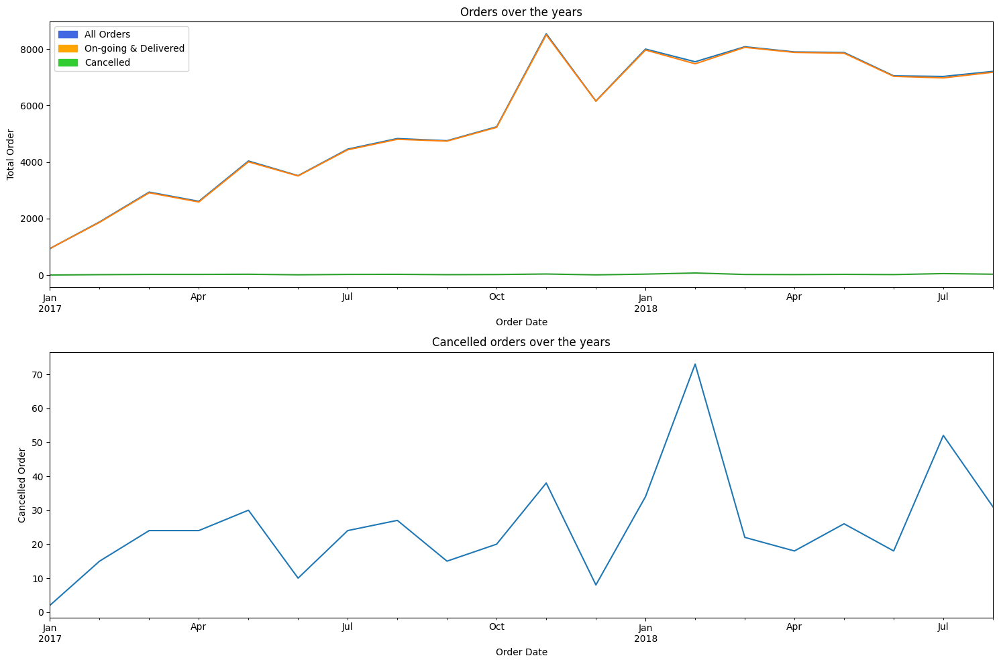

In [408]:
# Plot order trend
plt.figure(figsize=(15,10))
plt.subplot(2,1,1)
Order1 = mpatches.Patch(color='royalblue', label='All Orders')
Order2 = mpatches.Patch(color='orange', label='On-going & Delivered')
Order3 = mpatches.Patch(color='limegreen', label='Cancelled')
dataset.groupby(dataset['order_purchase_timestamp'].dt.to_period('M'))['order_item_id'].count().plot()
dataset[dataset['order_status']!='canceled'].groupby(dataset['order_purchase_timestamp'].dt.to_period('M'))['order_item_id'].count().plot()
dataset[dataset['order_status']=='canceled'].groupby(dataset['order_purchase_timestamp'].dt.to_period('M'))['order_item_id'].count().plot()
plt.legend(handles = [Order1, Order2, Order3], loc="upper left")
plt.xlabel('Order Date')
plt.ylabel('Total Order')
plt.title('Orders over the years')
plt.subplot(2,1,2)
dataset[dataset['order_status']=='canceled'].groupby(dataset['order_purchase_timestamp'].dt.to_period('M'))['order_item_id'].count().plot()
plt.xlabel('Order Date')
plt.ylabel('Cancelled Order')
plt.title('Cancelled orders over the years')

plt.tight_layout()
plt.show()

Overall the graph shows an increasing trend in purchases from Jan 2017 until Aug 2018. Peak of purchase is in Nov 2017 (May be caused by Black Friday sales and pre-Christmas), and it hit a slight down trend in Dec 2017 and goes back up in Jan 2018 (May be caused by post holiday discounts). From Jan 2018 until Aug 2018 tend to show a stagnant trend. 

Cancelled orders were few compared to successful orders. The highest cancelled order were in Feb 2018. The trend of cancelled orders are usually directly proportional to the amount of order, but it is shown that in Feb 2018 and Jul 2018 cancelled orders don't follow that trend. 

Text(0.5, 1.0, 'Count of Orders based on Days')

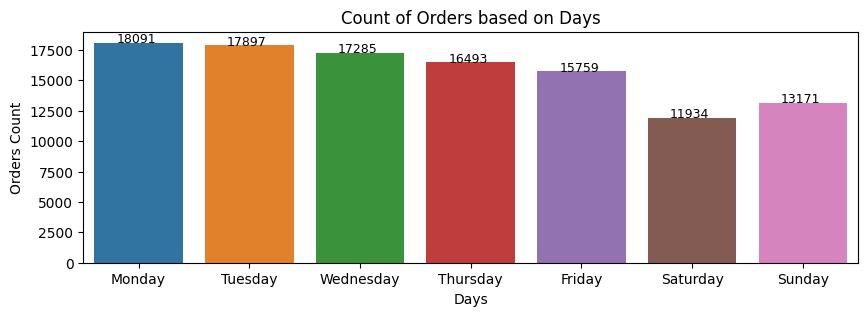

In [409]:
# Count of orders based on days
order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday','Sunday']
plt.figure(figsize=(10,3))
daysorder = sns.countplot(data=dataset, x='Day',order = order)
for bar in daysorder.patches:
        count = bar.get_height()
        x = bar.get_x() + bar.get_width()/4
        y = bar.get_y() + bar.get_height()+10
        daysorder.annotate(count, (x, y), size = 9)

plt.xlabel('Days')
plt.ylabel('Orders Count')
plt.title('Count of Orders based on Days')

2022-11-29 10:49:32,602 | INFO | category.py:234 | update | Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2022-11-29 10:49:32,610 | INFO | category.py:234 | update | Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


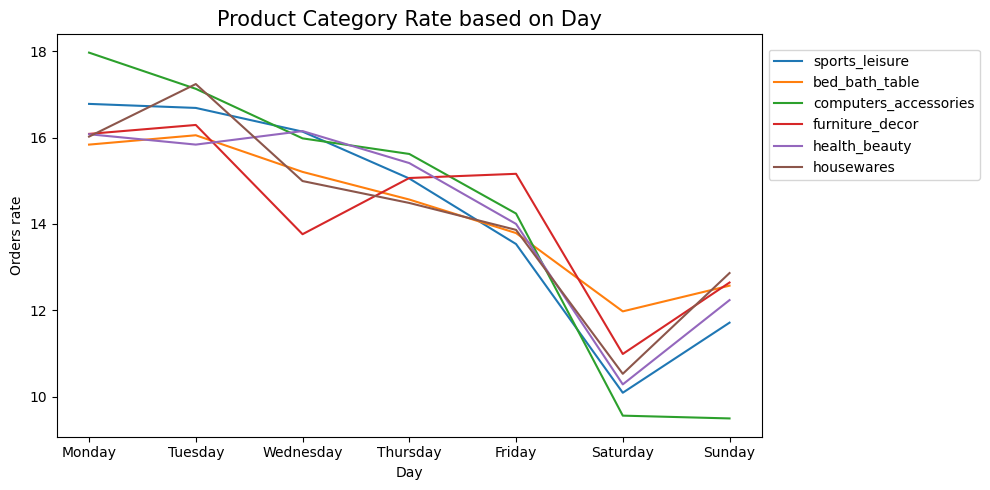

In [410]:
# Order per product category based on days
plt.figure(figsize = [10,5])
prodper = dataset.loc[dataset['product_category'].isin(['bed_bath_table','health_beauty','sports_leisure','furniture_decor','computers_accessories', 'housewares'])]
prodper = prodper[prodper['order_status']!='canceled'].groupby(['Day', 'product_category'])['order_item_id'].count().reset_index()
totalcat = prodper.groupby('product_category').sum('order_item_id').reset_index()
prodper= pd.merge(prodper, totalcat, on = 'product_category', how ='left')
prodper['avg'] = prodper['order_item_id_x']/prodper['order_item_id_y']*100
sorter = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday','Sunday']
sorterIndex = dict(zip(sorter,range(len(sorter))))
prodper['Day_id'] = prodper.index
prodper['Day_id'] = prodper['Day'].map(sorterIndex)
prodper = prodper.sort_values(by = 'Day_id')
sns.lineplot(data=prodper, x='Day', y='avg', hue='product_category').set_title('Product Category Rate based on Day', size=15)
ax = plt.subplot(111)
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 1, box.height])
ax.legend(loc='center left', bbox_to_anchor=(1, 0.8))
plt.ylabel('Orders rate')
plt.tight_layout()
plt.show()

Most purchases occur on weekdays, there is a decrease of purchases through the weekends. There are 2 things that we can conclude:
1. Promotions can be made by knowing which day does the product category have the highest order or preference. Computer accessories and sport leisure are best for the start of the weekdays, housewares on Tuesday, health beauty and furniture decor by the end of weekdays, bed bath table and more housewares & furniture decor on the weekend
3. If the data also shows how many times the customer opened the platform then through the weekends E-commerce should have push notification showing best deals or recommended items based on each customer to increase customers engagement rate. 

Next is to check order status.

Text(0.5, 1.0, 'Count and Percentage of Order Status')

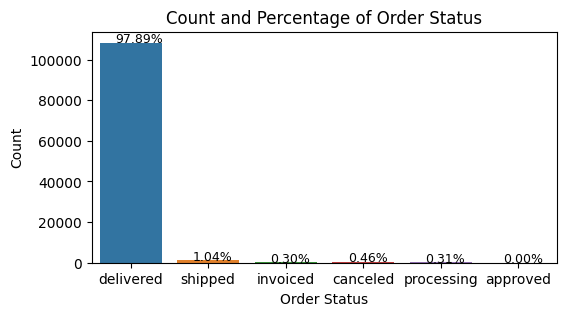

In [411]:
# Order Status
plt.figure(figsize=(6,3))
orderstatus = sns.countplot(data=dataset, x='order_status')
for bar in orderstatus.patches:
        percentage = '{:.2f}%'.format(bar.get_height()/dataset.shape[0]*100)
        x = bar.get_x() + bar.get_width()/4
        y = bar.get_y() + bar.get_height()+10
        orderstatus.annotate(percentage, (x, y), size = 9)

plt.xlabel('Order Status')
plt.ylabel('Count')
plt.title('Count and Percentage of Order Status')

From the graph above it is known that 97.89% of orders are successful until delivered and only 0.46% of orders are cancelled which shows low cancellation rate and the company is performing well. Cancelled orders may affect the seller and the platform through negative reviews, next step is to analyse customers' feedbacks.

* **Review Analysis**

In [412]:
# Dataset for reviews
datareview = dataset[dataset['order_id'].duplicated() == False].merge(df_reviews, on = 'order_id', how = 'inner')
datareview.dropna(subset=('review_score'), axis = 0, inplace = True)
datareview['review_score']= datareview['review_score'].astype('int64')

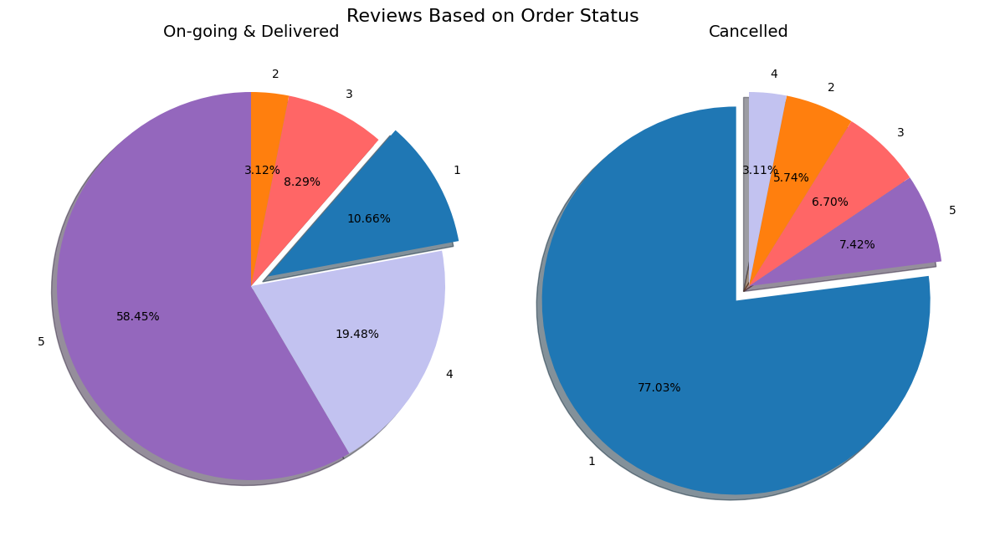

In [413]:
# Check Reviews based on order-status
pielabels1 = ['5','4','1','3','2']
pielabels2 = ['1','5','3','2','4']

colours = {'1': 'C0',
           '2': 'C1',
           '3': '#ff6666',
           '4': '#c2c2f0',
           '5' : 'C4'}

plt.figure(figsize=(18,7))
plt.suptitle('Reviews Based on Order Status', size=16, x=0.33, y=.95)
plt.subplot(1,3,1)
plt.pie(datareview[datareview['order_status']!='canceled']['review_score'].value_counts(), labels=pielabels1, colors=[colours[key] for key in pielabels1], autopct='%1.2f%%',explode=(0,0,0.1,0,0), textprops={'fontsize': 10},shadow=True, startangle=90)
plt.title('On-going & Delivered', size=14)
plt.subplot(1,3,2)
plt.pie(datareview[datareview['order_status']=='canceled']['review_score'].value_counts(), labels=pielabels2, colors=[colours[key] for key in pielabels2], autopct='%1.2f%%',explode=(0.1,0,0,0,0), textprops={'fontsize': 10},shadow=True, startangle=90)
plt.title('Cancelled', size=14)
plt.tight_layout()
plt.show()

It is known that majority of customers with successful orders are satisfied with the service and the product (rated 4: 19.48%, rated 5:58.45%), while the majority of cancelled orders are dissatisfied (rated 1: 77.03%). Knowing what causes dissatisfaction will be useful to understand which improvement to be made. 

In [414]:
# Check Top 10 Cat Highest Order & Top 10 Lowest Review
a = datareview['product_category'].value_counts().reset_index().head(10)
b = datareview[datareview['review_score']<3]['product_category'].value_counts().reset_index().head(10)
c = round(datareview[datareview['review_score']<3]['product_category'].value_counts().head(10)/datareview['product_category'].value_counts().head(10)*100,2).reset_index()
a = a.merge(b, on = 'index', how = 'outer')
a = a.merge(c, on = 'index', how = 'outer')
a.rename(columns={'product_category_x': 'Top 10 Highest Order','product_category_y':'Top 10 Lowest Review','product_category':'Percentage'})

,index,Top 10 Highest Order,Top 10 Lowest Review,Percentage
0,bed_bath_table,9286,1532,16.50
1,health_beauty,8753,1090,12.45
2,sports_leisure,7675,989,12.89
3,computers_accessories,6663,1064,15.97
4,furniture_decor,6319,1039,16.44
5,housewares,5845,764,13.07
6,watches_gifts,5560,840,15.11
7,telephony,4146,635,15.32
8,auto,3866,547,14.15
9,toys,3818,479,12.55


From this data the top 5 categories with high orders are bed bath table, health beauty, sports leisure, computer accessories, and furniture decor. These categories attract most customers, showing these top 5 categories on landing page and giving discounts based on categories may attract new customers.
  
The highest percentage with low reviews are bed bath table, furniture decor, and computer accessories. The top 10 categories with lowest review have the highest order/purchase, thus just looking at this information may be biased. Thus next step is to analyze based on periods.  

In [415]:
# Change review score into categorical (Neutral & Dissatisfied, Satisfied)
def satisfaction (ReviewScore): 
    if ReviewScore <= 3: 
        return 'Neutral & Dissatisfied'
    elif ReviewScore >3:
        return 'Satisfied'
    
datareview['Satisfaction'] = datareview["review_score"].apply(lambda ReviewScore: satisfaction(ReviewScore))

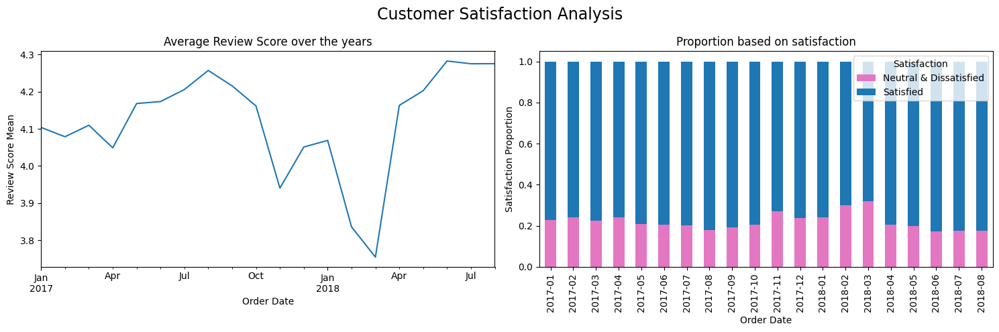

In [416]:
# Check mean of rates given through out the year
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
datareview.groupby(datareview['order_purchase_timestamp'].dt.to_period('M'))['review_score'].mean().plot()
plt.xlabel('Order Date')
plt.ylabel('Review Score Mean')
plt.title('Average Review Score over the years')

ax = plt.subplot(1,2,2)
datareview.pivot_table(index=datareview['order_purchase_timestamp'].dt.to_period('M'), columns='Satisfaction', values='order_item_id', aggfunc='count')
x = pd.crosstab(datareview['order_purchase_timestamp'].dt.to_period('M'),datareview['Satisfaction'],normalize='index').sort_index()
x.plot(color=['tab:pink',"tab:blue"], kind='bar', stacked=True, ax =ax)
plt.xlabel('Order Date')
plt.ylabel('Satisfaction Proportion')
plt.title('Proportion based on satisfaction')

plt.suptitle('Customer Satisfaction Analysis', size =17)
plt.tight_layout()
plt.show()

Highest proportion of neutral and dissatisfied customers are in Nov 2017, Feb 2018, and Mar 2018. These low reviews may be the cause of the stagnant trend from Apr 2018 - Aug 2018. Next step is to check review comments of Neutral and Dissatisfied Customers. To check the frequency of words, the comments will go through text mining.  

In [417]:
# Check most common comment with review score <= 3
dataComment = datareview[(datareview['Satisfaction']=='Neutral & Dissatisfied') & (datareview['review_comment_message']!= 'No Comment')]
dataComment.shape

(13633, 32)

In [418]:
# Text mining
dataComment['review_comment_message'] = dataComment['review_comment_message'].apply(lambda text : text.lower())
dataComment['review_comment_message'] = dataComment['review_comment_message'].apply(lambda text : contractions.fix(text))
dataComment['review_comment_message'] = dataComment['review_comment_message'].apply(lambda text : ' '.join([word for word in text.split() if not word.isdigit()]))
dataComment['review_comment_message'] = dataComment['review_comment_message'].apply(lambda text :''.join([word for word in text if word not in punctuation]))
dataComment['review_comment_message'] = dataComment['review_comment_message'].apply(lambda text : ' '.join([word for word in text.split()]))
pt_stopwords = stopwords.words('portuguese')
dataComment['review_comment_message'] = dataComment['review_comment_message'].apply(lambda text : ' '.join([word for word in nltk.word_tokenize(text) if word not in pt_stopwords]))
snowball_stemmer = SnowballStemmer("portuguese")
dataComment['review_comment_message'] = dataComment['review_comment_message'].apply(lambda text : ' '.join([snowball_stemmer.stem(word) for word in nltk.word_tokenize(text)]))

word_freq = adv.word_frequency(text_list=dataComment['review_comment_message'])
Top25Comments = word_freq.sort_values(by='abs_freq', ascending=False).head(25)
Top25Comments.rename(columns = {'word':'Bad Review','abs_freq':'Frequency'},inplace = True)
Top25Comments

,Bad Review,Frequency
0,produt,7787
1,receb,4361
2,entreg,4045
3,compr,3811
4,vei,2016
5,cheg,1967
6,aind,1594
7,ped,1352
8,praz,1302
9,nao,1035


In [419]:
# Translate
Top25Comments['Bad Review Eng'] =['product','receive','delivery','buy','came','arrived','still','ped','not','store','other','wait','day','run','like','post office','miss','Act','only','send','whether','wait','although','delay','then']
Top25Comments = Top25Comments[['Bad Review','Bad Review Eng', 'Frequency']]
Top25Comments.head()

,Bad Review,Bad Review Eng,Frequency
0,produt,product,7787
1,receb,receive,4361
2,entreg,delivery,4045
3,compr,buy,3811
4,vei,came,2016


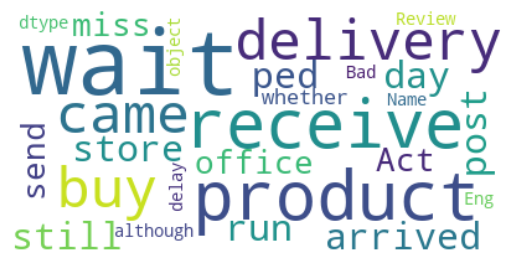

In [420]:
# Check most frequent words
word_cloud = WordCloud(collocations = False, background_color = 'white').generate(str(Top25Comments['Bad Review Eng']))
plt.imshow(word_cloud, interpolation='bilinear')
plt.axis("off")
plt.show()

Based from text mining, the most frequent words involve 'product', 'delivery', and 'delay'. Because 'product' is a neutral word it will take so much time to analyze the comment for each category, thus it is recommended to make a machine learning regarding sentiment analysis to understand if a comment is negative or positive. Moreover we can see the majority of customers are dissatisfied due to the delivery delay and wait too long to receive the order. So to move forward with the analysis we will focus on delivery.

In [421]:
# Seller
dataset2 = dataset.copy()
dataset['seller_approved_h'] = (dataset['order_approved_at']-dataset['order_purchase_timestamp']).dt.total_seconds()/3600
dataset['shipping_limit_time'] = (dataset['shipping_limit_date']-dataset['order_approved_at']).dt.total_seconds()/3600/24
dataset['shipping_actual_time'] = (dataset['order_delivered_carrier_date']-dataset['order_approved_at']).dt.total_seconds()/3600/24
dataset['shipping_gap'] = (dataset['shipping_limit_date']-dataset['order_delivered_carrier_date']).dt.total_seconds()/3600/24

# Delivery Partners
dataset['delivery_estimation'] = (dataset['order_estimated_delivery_date']-dataset['order_delivered_carrier_date']).dt.total_seconds()/3600/24
dataset['delivery_actual'] = (dataset['order_delivered_customer_date']-dataset['order_delivered_carrier_date']).dt.total_seconds()/3600/24
dataset['delivery_gap'] = (dataset['order_estimated_delivery_date']-dataset['order_delivered_customer_date']).dt.total_seconds()/3600/24

dataset.dropna(subset = ['delivery_gap'],axis = 0, inplace = True)
dataset = dataset[dataset['order_status']!='canceled']

dataset.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_weight_g,product_category,seller_zip_code_prefix,seller_city,seller_state,Month,Year,Day,seller_approved_h,shipping_limit_time,shipping_actual_time,shipping_gap,delivery_estimation,delivery_actual,delivery_gap
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16,2017-05-16,2017-05-23,2017-05-25,2017-06-05,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22,124.99,21.88,8683.0,office_furniture,8577,itaquaquecetuba,SP,5,2017,Tuesday,0.0,6.0,7.0,-1.0,13.0,2.0,11.0
1,8912fc0c3bbf1e2fbf35819e21706718,9eae34bbd3a474ec5d07949ca7de67c0,68030,santarem,PA,c1d2b34febe9cd269e378117d6681172,delivered,2017-11-09,2017-11-10,2017-11-22,2017-11-28,2017-12-19,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-11-23,112.99,24.90,8683.0,office_furniture,8577,itaquaquecetuba,SP,11,2017,Thursday,24.0,13.0,12.0,1.0,27.0,6.0,21.0
2,8912fc0c3bbf1e2fbf35819e21706718,9eae34bbd3a474ec5d07949ca7de67c0,68030,santarem,PA,c1d2b34febe9cd269e378117d6681172,delivered,2017-11-09,2017-11-10,2017-11-22,2017-11-28,2017-12-19,2,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-11-23,112.99,24.90,8683.0,office_furniture,8577,itaquaquecetuba,SP,11,2017,Thursday,24.0,13.0,12.0,1.0,27.0,6.0,21.0
3,f0ac8e5a239118859b1734e1087cbb1f,3c799d181c34d51f6d44bbbc563024db,92480,nova santa rita,RS,b1a5d5365d330d10485e0203d54ab9e8,delivered,2017-05-07,2017-05-08,2017-05-19,2017-05-26,2017-06-12,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22,124.99,15.62,8683.0,office_furniture,8577,itaquaquecetuba,SP,5,2017,Sunday,24.0,14.0,11.0,3.0,24.0,7.0,17.0
4,6bc8d08963a135220ed6c6d098831f84,23397e992b09769faf5e66f9e171a241,25931,mage,RJ,2e604b3614664aa66867856dba7e61b7,delivered,2018-02-03,2018-02-04,2018-02-19,2018-02-28,2018-03-22,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2018-02-18,106.99,30.59,8683.0,office_furniture,8577,itaquaquecetuba,SP,2,2018,Saturday,24.0,14.0,15.0,-1.0,31.0,9.0,22.0


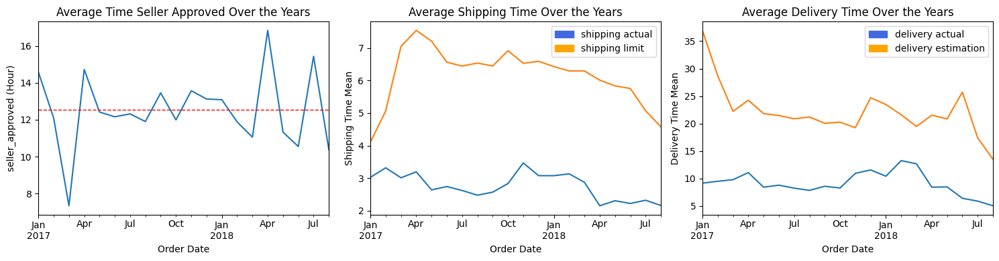

In [422]:
# Shipping and Delivery Plot
plt.figure(figsize =(15,4))
plt.subplot(1,3,1)
dataset.groupby(dataset['order_purchase_timestamp'].dt.to_period('M'))['seller_approved_h'].mean().plot()
plt.axhline(y=np.nanmean(dataset['seller_approved_h']), color='red', linestyle='--', linewidth=1, label='Avg')
plt.xlabel('Order Date')
plt.ylabel('seller_approved (Hour)')
plt.title('Average Time Seller Approved Over the Years')

plt.subplot(1,3,2)
Order1 = mpatches.Patch(color='royalblue', label='shipping actual')
Order2 = mpatches.Patch(color='orange', label='shipping limit')
dataset.groupby(dataset['order_purchase_timestamp'].dt.to_period('M'))['shipping_actual_time'].mean().plot()
dataset.groupby(dataset['order_purchase_timestamp'].dt.to_period('M'))['shipping_limit_time'].mean().plot()
plt.legend(handles = [Order1, Order2], loc="upper right")
plt.xlabel('Order Date')
plt.ylabel('Shipping Time Mean')
plt.title('Average Shipping Time Over the Years')

plt.subplot(1,3,3)
Order1 = mpatches.Patch(color='royalblue', label='delivery actual')
Order2 = mpatches.Patch(color='orange', label='delivery estimation')
dataset.groupby(dataset['order_purchase_timestamp'].dt.to_period('M'))['delivery_actual'].mean().plot()
dataset.groupby(dataset['order_purchase_timestamp'].dt.to_period('M'))['delivery_estimation'].mean().plot()
plt.legend(handles = [Order1, Order2], loc="upper right")
plt.xlabel('Order Date')
plt.ylabel('Delivery Time Mean')
plt.title('Average Delivery Time Over the Years')
plt.tight_layout()
plt.show()

There are several things that we can conclude:
1. Graph.1 : Overall average sellers approval time is low with average 12.56Hour(<1Day)
2. Graph.2 : Overall majority of sellers send the orders to the courier under the shipping limit given by the E-commerce. Shipping limit set by the E-commerce might be too long with approximately 6 days(average). E-commerce can shorten the shipping limit so that overall delivery will be faster.
3. Graph.3 : Overall average estimation is far from delivery prediction. E-commerce should make better prediction to increase accuracy, so that the actual delivery time can meet customer's expectation.

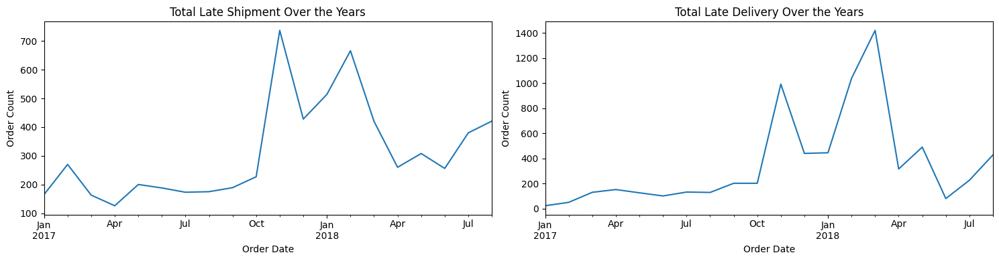

In [423]:
# Plot Shipment and Delivery Delay
plt.figure(figsize=(15,4))
plt.subplot(1,2,1)
dataset[dataset['shipping_gap']<0].groupby(dataset['order_purchase_timestamp'].dt.to_period('M'))['shipping_gap'].count().plot()
plt.xlabel('Order Date')
plt.ylabel('Order Count')
plt.title('Total Late Shipment Over the Years')

plt.subplot(1,2,2)
dataset[dataset['delivery_gap']<0].groupby(dataset['order_purchase_timestamp'].dt.to_period('M'))['delivery_gap'].count().plot()
plt.xlabel('Order Date')
plt.ylabel('Order Count')
plt.title('Total Late Delivery Over the Years')

plt.tight_layout()
plt.show()

The highest orders with late shipment by sellers are in Nov 2017, Jan 2018, and Feb 2018. Moreover the highest orders with late delivery by couriers are in Nov 2017, Feb 2018, and Mar 2018. This shows that the data corresponds to the low reviews. After Mar 2018 there are some late delivery orders that are also higher than usual. This problems need to be solved to avoid customers' low reviews and satisfaction. E-commerce might do several actions to avoid this problem: 
1. Analyze upcoming purchase trend to prepare for high seasons for big holidays such as Black Friday, Christmas, and New Years. This analysis can be done by making time series machine learning by predicting upcoming order patterns. Socialize the analysis results to sellers and expedition partners to avoid slow pace orders preparation and execution. 
2. Partner with more expeditions so the orders will be distributed to several expedition to anticipate over-loading, moreover to inspire expeditions to be more competitive. 
  
Next step is to check based on Location.

In [424]:
# Preparing Dataset
df_geo.drop_duplicates(subset = 'geolocation_zip_code_prefix', inplace = True)
datareviewcust = pd.merge(datareview, df_geo, left_on= 'customer_zip_code_prefix', right_on =  'geolocation_zip_code_prefix', how = 'left')
datareviewseller = pd.merge(datareviewcust, df_geo, left_on= 'seller_zip_code_prefix', right_on =  'geolocation_zip_code_prefix', how = 'left')
datareviewcust.shape

(96725, 37)

In [425]:
# Customer Distribution based on Satisfaction
fig = px.scatter_mapbox(datareviewcust[datareviewcust['review_score']<4], lat='geolocation_lat', lon='geolocation_lng', color='review_score', hover_data=['product_category','customer_city','customer_state'],
                        color_discrete_sequence=px.colors.qualitative.Safe, zoom=9.5, height=500, width=700, opacity=1,
                        title='Neutral and Dissatisfied Customer Distribution')
fig.update_traces(marker=dict(size=5))
fig.update_layout(mapbox_style='carto-darkmatter',margin=dict(l=10,r=0,t=40,b=10))
fig.show()

In [426]:
# Seller Distribution
fig = px.scatter_mapbox(datareviewseller, lat='geolocation_lat_y', lon='geolocation_lng_y', color='review_score', hover_data=['product_category','customer_city','customer_state'],
                        color_discrete_sequence=px.colors.qualitative.Safe, zoom=9.5, height=500, width=700, opacity=1,
                        title='Seller Distribution')
fig.update_traces(marker=dict(size=5))
fig.update_layout(mapbox_style='carto-darkmatter',margin=dict(l=10,r=0,t=40,b=10))
fig.show()

**Pyplot.express usually can't be read in Github, here are the customer and seller distribution:**

![Getting Started](plotcustomerdistribution.png)

![Getting Started](plotsellerdistribution.png)

In [427]:
# Check unique
print (f'''total unique customer : {df_customers['customer_unique_id'].nunique()}, 
total unique seller : {df_sellers['seller_id'].nunique()}, 
percentage: {round(df_sellers['seller_id'].nunique()/df_customers['customer_unique_id'].nunique()*100,2)}%''')

total unique customer : 96096, 
total unique seller : 3095, 
percentage: 3.22%


From the plot above, we can see that customers with low review scores are highly distributed over the country compared to seller distribution. When looking at the total unique of customer(satisfied,neutral & dissatisfied) is 96096 and total unique of seller is 3095. This shows seller is only 3.22% percent of customers. E-commerce might reach out to more sellers to join the platform and give benefit for new sellers such as coupons for free delivery/products discount. Moreover look for the location with low sellers in the state and high demand buyers, these states can be the target to broaden seller partners.

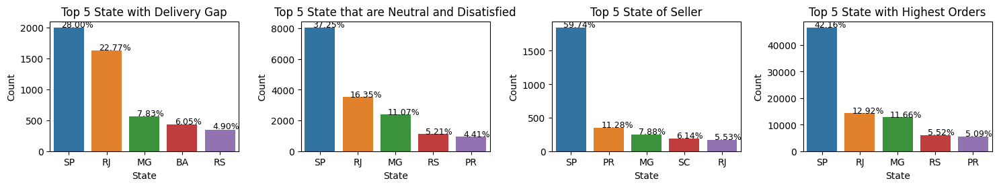

In [428]:
# State
plt.figure(figsize=(15,10))
plt.subplot(4,4,1)

orderstatus = sns.countplot(data=dataset[dataset['delivery_gap']<0], x='customer_state', order = dataset[dataset['delivery_gap']<0]['customer_state'].value_counts().iloc[:5].index)
for bar in orderstatus.patches:
        percentage = '{:.2f}%'.format(bar.get_height()/dataset[dataset['delivery_gap']<0].shape[0]*100)
        x = bar.get_x() + bar.get_width()/4
        y = bar.get_y() + bar.get_height()+10
        orderstatus.annotate(percentage, (x, y), size = 9)

plt.xlabel('State')
plt.ylabel('Count')
plt.title('Top 5 State with Delivery Gap')
plt.subplot(4,4,2)
orderstatus = sns.countplot(data=datareview[datareview['review_score']<4], x='customer_state',order = datareview[datareview['review_score']<4]['customer_state'].value_counts().iloc[:5].index)
for bar in orderstatus.patches:
        percentage = '{:.2f}%'.format(bar.get_height()/datareview[datareview['review_score']<4].shape[0]*100)
        x = bar.get_x() + bar.get_width()/4
        y = bar.get_y() + bar.get_height()+10
        orderstatus.annotate(percentage, (x, y), size = 9)

plt.xlabel('State')
plt.ylabel('Count')
plt.title('Top 5 State that are Neutral and Disatisfied')

plt.subplot(4,4,3)
orderstatus = sns.countplot(data=df_sellers, x='seller_state', order = df_sellers['seller_state'].value_counts().iloc[:5].index)
for bar in orderstatus.patches:
        percentage = '{:.2f}%'.format(bar.get_height()/df_sellers.shape[0]*100)
        x = bar.get_x() + bar.get_width()/4
        y = bar.get_y() + bar.get_height()+10
        orderstatus.annotate(percentage, (x, y), size = 9)

plt.xlabel('State')
plt.ylabel('Count')
plt.title('Top 5 State of Seller')

plt.subplot(4,4,4)
orderstatus = sns.countplot(data=dataset2, x='customer_state', order = dataset2['customer_state'].value_counts().iloc[:5].index)
for bar in orderstatus.patches:
        percentage = '{:.2f}%'.format(bar.get_height()/dataset2.shape[0]*100)
        x = bar.get_x() + bar.get_width()/4
        y = bar.get_y() + bar.get_height()+10
        orderstatus.annotate(percentage, (x, y), size = 9)

plt.xlabel('State')
plt.ylabel('Count')
plt.title('Top 5 State with Highest Orders')

plt.tight_layout()
plt.show()

The top 3 states with highest orders are SP, RJ, and MG, while the top 3 states with highest sellers are SP, PR, and MG. Eventhough SP has the highest seller, it still has the highest delivery gap and neutral&dissatisfied customers, this shows the demand is really high and the courier may be over-loaded. RJ and MG has the 2nd and 3rd highest demand but with high delivery gap and neutral&dissatisfied customers. It is recommended to make a warehouse in SP, RJ, and MG or look for sellers in these areas. 

* **Cohort Analysis**

As we can see before from the order trend analysis, E-commerce is growing and has incline trend. To really understand if customers have good retention of the platform we use Cohort Analysis based on orders done by each customers. 

In [429]:
# Dataset preparation
dataset2 = pd.merge(dataset2, dataset2.groupby('customer_unique_id',as_index=False)['order_purchase_timestamp'].min().rename(columns ={'order_purchase_timestamp':'first_purchase'}), on = 'customer_unique_id', how = 'left')
dataset2['first_purchase'] = dataset2['first_purchase'].apply(lambda row : dt.datetime(row.year, row.month, 1))
Ydifference = dataset2['Year'] - dataset2['first_purchase'].dt.year
Mdifference = dataset2['order_purchase_timestamp'].dt.month - dataset2['first_purchase'].dt.month
dataset2['month_index'] = Ydifference*12 + Mdifference + 1
cohort = dataset2.groupby(['first_purchase','month_index'])
cohort = cohort['customer_unique_id'].apply(pd.Series.nunique).reset_index()
cohort['first_purchase'] = cohort['first_purchase'].dt.to_period('M')
cohort.head()

,first_purchase,month_index,customer_unique_id
0,2017-01,1,742
1,2017-01,2,3
2,2017-01,3,2
3,2017-01,4,1
4,2017-01,5,3


In [430]:
# Pivot - data prep
cohortpivot = pd.pivot_table(data = cohort, index = 'first_purchase', columns = 'month_index', values = 'customer_unique_id',aggfunc= 'sum', \
                     margins = True, margins_name='Total')
cohortpercentage = cohortpivot.apply(lambda data: round(data/cohortpivot.loc[:,1]*100,2))
cohortpercentage

month_index,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,20,Total
first_purchase,,,,,,,,,,,,,,,,,,,,
2017-01,100.0,0.40,0.27,0.13,0.40,0.13,0.40,0.13,NaN,NaN,0.40,0.13,0.54,0.40,0.13,0.13,0.27,0.40,0.13,104.45
2017-02,100.0,0.24,0.30,0.06,0.43,0.12,0.24,0.18,0.06,0.18,0.12,0.30,0.12,0.18,0.12,0.06,0.06,0.24,NaN,103.04
2017-03,100.0,0.51,0.35,0.35,0.35,0.16,0.16,0.31,0.35,0.08,0.35,0.12,0.24,0.12,0.16,0.24,0.08,0.16,NaN,104.08
2017-04,100.0,0.61,0.22,0.18,0.35,0.26,0.31,0.31,0.31,0.18,0.26,0.09,0.09,0.04,0.09,0.09,0.18,NaN,NaN,103.56
2017-05,100.0,0.49,0.46,0.37,0.32,0.35,0.43,0.14,0.23,0.26,0.26,0.29,0.26,0.03,0.17,0.26,NaN,NaN,NaN,104.31
2017-06,100.0,0.49,0.36,0.39,0.26,0.39,0.36,0.23,0.13,0.20,0.33,0.33,0.16,0.13,0.20,NaN,NaN,NaN,NaN,103.95
2017-07,100.0,0.53,0.34,0.24,0.26,0.21,0.32,0.11,0.18,0.26,0.21,0.29,0.13,0.26,NaN,NaN,NaN,NaN,NaN,103.34
2017-08,100.0,0.66,0.34,0.27,0.37,0.51,0.29,0.24,0.15,0.15,0.24,0.20,0.07,NaN,NaN,NaN,NaN,NaN,NaN,103.50
2017-09,100.0,0.67,0.50,0.30,0.45,0.20,0.22,0.25,0.30,0.20,0.27,0.07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,103.42


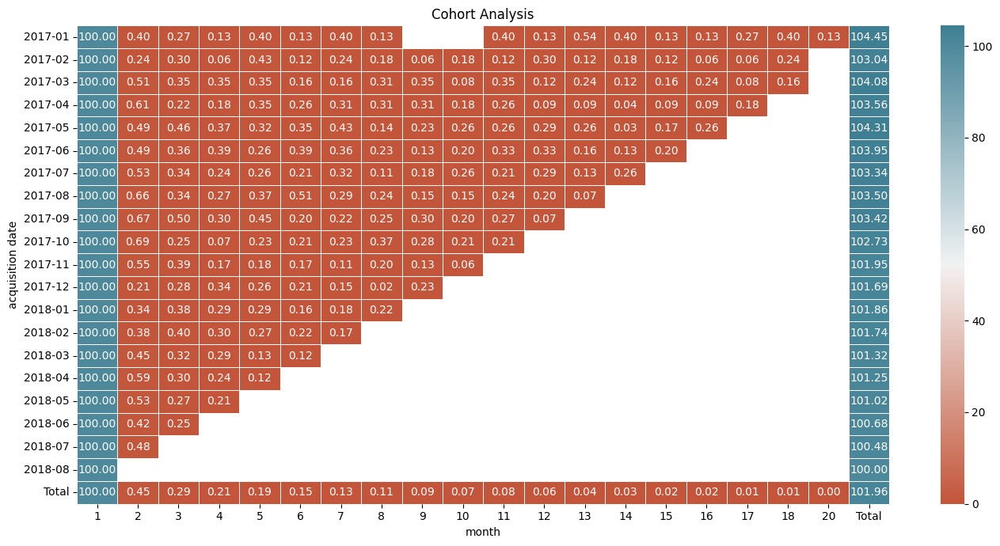

In [431]:
# Customer Retention - Cohort Analysis
plt.figure(figsize= (14,7))
sns.heatmap(cohortpercentage, annot=True, fmt='.2f',cmap=palette, linewidths=.5)
plt.title ('Cohort Analysis')
plt.xlabel('month')
plt.ylabel('acquisition date')
plt.tight_layout()
plt.show()

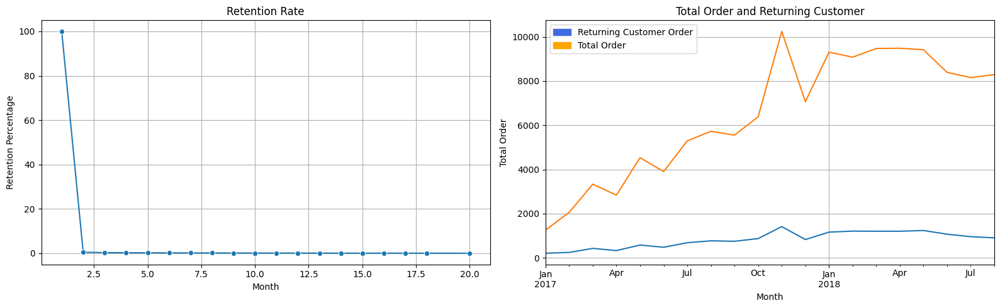

In [433]:
# Retention Plot
plt.figure(figsize = [16,5])
plt.subplot(1,2,1)
retention = cohortpercentage.reset_index()
retention = retention.iloc[-1,1:-1].reset_index()
retention = retention.rename(columns = {20: 'Rate'})
retention['Rate'] = retention['Rate'].astype('float64')
ax = sns.lineplot(data = retention, x = 'month_index', y = 'Rate',marker='o')
plt.grid()
plt.xlabel('Month')
plt.ylabel('Retention Percentage')
plt.title('Retention Rate')
plt.subplot(1,2,2)
dataset2 = dataset2[dataset2['order_status']=='delivered']
total_order = dataset2.set_index('order_purchase_timestamp')['order_item_id'].resample('M').sum()
customeruniquespent = dataset2[dataset2['customer_unique_id'].duplicated() == True].groupby(['customer_unique_id','order_purchase_timestamp']).agg(count = ('order_item_id', len),price_spent = ('price',np.sum)).reset_index()
custuniq= customeruniquespent.set_index('order_purchase_timestamp')['count'].resample('M').sum()
custuniq.plot()
total_order.plot()
Order1 = mpatches.Patch(color='royalblue', label='Returning Customer Order')
Order2 = mpatches.Patch(color='orange', label='Total Order')
plt.legend(handles = [Order1, Order2], loc="upper left")

plt.grid()
plt.xlabel('Month')
plt.ylabel('Total Order')
plt.title('Total Order and Returning Customer')

plt.tight_layout()
plt.show()

Eventhough the platform is growing (incline trend), we can see that overall customers' retention is low or we can say that there are new customers but old customers tend to churn. Study shows that acquiring a new customer can cost five times more than retaining an existing customer. E-commerce might make a machine learning to predict which customer is going to churn, these customers can be given special treatment(special offers). Other than that, E-commerce can make a loyal member subscription to keep customers interested and engaged in the platform or gain more active users. E-commerce can also give interesting push-notification to catch customer's attention.  

### Conclusion & Recommendation

From this analysis we can conclude:
1. Promotions can be made by knowing which day does the product category have the highest order or preference. Computer accessories and sport leisure are best for the start of the weekdays, housewares on Tuesday, health beauty and furniture decor by the end of weekdays, bed bath table and more housewares & furniture decor on the weekend
2. E-commerce have a growing trend but overall customers retention is low, E-commerce can give interesting push-notification especially on the weekends. Push notifications and landing page can be adjusted based on the top product categories with high demand or based on recommended items for each customer. Also have a member subpscription to keep customers interest. 
3. Broaden seller on the platform especially in SP, RJ, and MG. If possible make a warehouse to have more organized shipping system.
4. Overall orders are successfull until delivered and low cancel order rate (0.46%)
5. Lately there seems to be many low reviews regarding shipment and delivery, E-commerce can shorten shipping limit so overall delivery will be faster, and make better prediction of delivery estimation to increase accuracy to meet customer's expectation. ( ML Priority #1)
6. Make time series machine learning by predicting upcoming order patterns. Socialize the analysis results to sellers and expedition partners to avoid slow pace orders preparation and execution. Partner with more expeditions so the orders will be distributed to several expedition to anticipate over-loading, moreover to inspire expeditions to be more competitive. (ML Priority #2)
3. Make a machine learning to predict customer churn, these predicted customers can be given special treatment by analyzing what causes churn(ML Priority #3)
8. Make a machine learning regarding sentiment analysis based on comments to understand customers feedback.(ML Priority #4)